# Style Transfer with a Wasserstein Metric 

This is a pytorch implementation of [Style Transfer as Optimum Transport](https://github.com/VinceMarron/style_transfer) by Vince Marron. 

This technique uses an L2-Wasserstein distance to optimize style transfer from one image to another. Similar to the [Gatys et. al](https://arxiv.org/abs/1508.06576) approach, the content image and the style image are passed through a pretrained convolutional model (in this cae VGG16) and the activations of both images at various layers are used as input to the loss function.

Unlike the Gatys approach, this technique does not use a combination of content loss and style loss. There is only one loss function - the L2-Wasserstein metric.

To simplify calculation of the metric, this technique assumes that the activations input into the loss function are multivariate Gaussian distributions modeled by the first two moments. This allows for a very straightforward calculation of the loss.

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import torch, torch.nn.functional as F
from torch import ByteTensor, DoubleTensor, FloatTensor, HalfTensor, LongTensor, ShortTensor, Tensor
from torch import nn, optim, as_tensor
from torch.utils.data import BatchSampler, DataLoader, Dataset, Sampler, TensorDataset
import torchvision
import math, matplotlib.pyplot as plt, numpy as np, pandas as pd, random
import PIL
from torchvision.models import vgg16_bn

In [3]:
from functools import partial

In [4]:
torch.backends.cudnn.benchmark=True

In [5]:
#Forward hooks to grab activations
class SaveFeatures():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output
    def close(self): self.hook.remove()

In [6]:
m_vgg = list(vgg16_bn(True).children())[0].eval().cuda()

This is the content image that we will transfer style to.

In [7]:
cnt_fn = 'styles/wave_small.jpg'

In [8]:
cnt_img_ob = PIL.Image.open(cnt_fn)

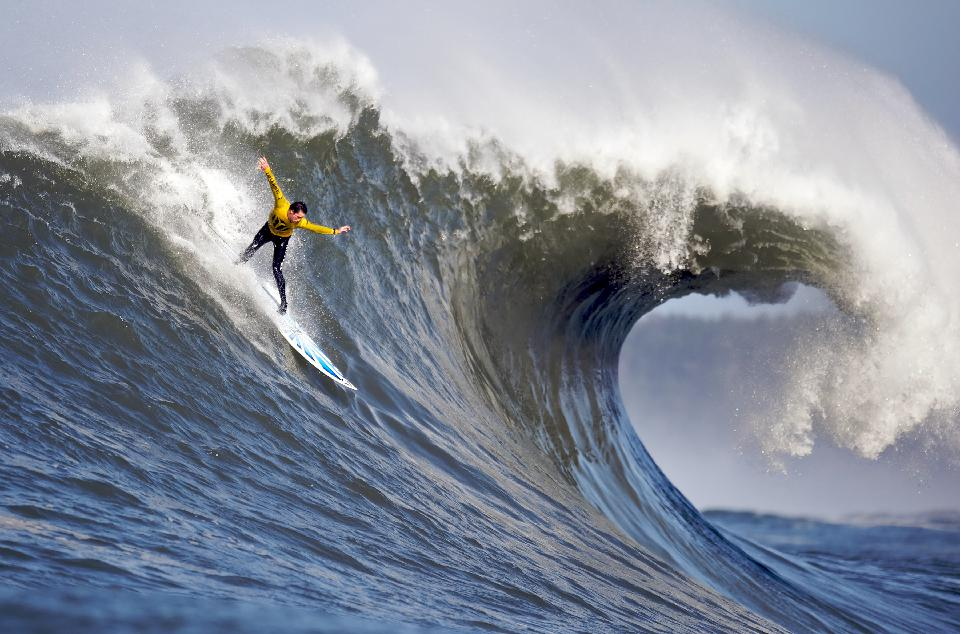

In [9]:
cnt_img_ob

This is the style image. It is not required for both images to be the same size. I have also found that the output images look better if you don't normalize the input images.

In [10]:
style_fn = 'styles/The_Great_Wave_off_Kanagawa.jpg'

In [11]:
style_img_ob = PIL.Image.open(style_fn)

In [12]:
style_img_ob = style_img_ob.resize((960, 634))

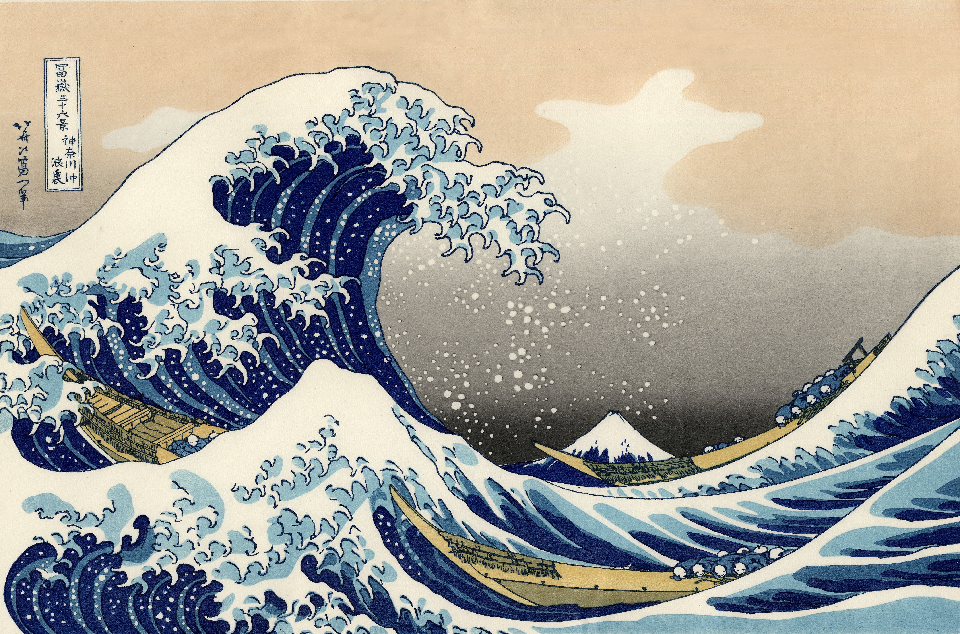

In [13]:
style_img_ob

In [14]:
def pil2tensor(image):
    arr = ByteTensor(torch.ByteStorage.from_buffer(image.tobytes()))
    arr = arr.view(image.size[1], image.size[0], -1)
    return arr.permute(2,0,1).float().div_(255)

In [15]:
cnt_tensor = pil2tensor(cnt_img_ob)

In [16]:
style_tensor = pil2tensor(style_img_ob)

In [17]:
cnt_tensor = cnt_tensor[None].cuda()

In [18]:
style_tensor = style_tensor[None].cuda()

This is the calculation of the L2-Wasserstein loss, based on this equation:

![text](styles/wass_loss.png)

In [19]:
def calc_2_moments(tensor):
    chans = tensor.shape[1]
    tensor = tensor.view(1, chans, -1)
    n = tensor.shape[2]
    
    mu = tensor.mean(2)
    tensor = (tensor - mu[:,:,None]).squeeze(0)
    cov = torch.mm(tensor, tensor.t()) / float(n)
    
    return mu, cov

In [20]:
def get_style_vals(tensor):
    mean, cov = calc_2_moments(tensor)
    
    eigvals, eigvects = torch.symeig(cov, eigenvectors=True)
    
    eigroot_mat = torch.diag(torch.sqrt(eigvals.clamp(min=0)))
    
    root_cov = torch.mm(torch.mm(eigvects, eigroot_mat), eigvects.t())
    
    tr_cov = eigvals.clamp(min=0).sum()
    
    return mean, tr_cov, root_cov

In [21]:
def calc_l2wass_dist(mean_stl, tr_cov_stl, root_cov_stl, mean_synth, cov_synth):
    
    tr_cov_synth = torch.symeig(cov_synth, eigenvectors=True)[0].clamp(min=0).sum()
    
    mean_diff_squared = (mean_stl - mean_synth).pow(2).sum()
    
    cov_prod = torch.mm(torch.mm(root_cov_stl, cov_synth), root_cov_stl)
    
    var_overlap = torch.sqrt(torch.symeig(cov_prod, eigenvectors=True)[0].clamp(min=0)+1e-8).sum()
    
    dist = mean_diff_squared + tr_cov_stl + tr_cov_synth - 2*var_overlap
    
    return dist

In [22]:
def single_wass_loss(pred, targ):
    mean_test, tr_cov_test, root_cov_test = targ
    mean_synth, cov_synth = calc_2_moments(pred)
    loss = calc_l2wass_dist(mean_test, tr_cov_test, root_cov_test, mean_synth, cov_synth)
    return loss

In [23]:
def wass_loss(input_tensor):
    m_vgg(input_tensor)
    outs = [o.features for o in sfs]

    losses = [single_wass_loss(p, t) for p, t in zip(outs, targ_stats)]
    return sum(losses)

# Style Transfer

The design choices here are what layers of the network to use for optimization and what optimizer to use. Here we use 13 conv layer outputs from VGG16 and optimize with LBFGS.

In [24]:
#conv out
block_ends = [0, 3, 7, 10, 14, 17, 20, 24, 27, 30, 34, 37, 40]

In [25]:
sfs = [SaveFeatures(list(m_vgg.children())[idx]) for idx in block_ends]
m_vgg(style_tensor);

In [26]:
#Calculate target values - only needs to be done once
targ_styles = [o.features.clone().detach().requires_grad_(False) for o in sfs]
targ_stats = [get_style_vals(i) for i in targ_styles]

In [28]:
input_tensor = cnt_tensor.clone().detach().requires_grad_(True)
opt = optim.LBFGS([input_tensor])

In [29]:
def step(loss_fn):
    global n_iter
    opt.zero_grad()
    loss = loss_fn(input_tensor)
    loss.backward()
    n_iter+=1
    if n_iter%50==0:
        print(f'Iteration: {n_iter}, loss: {loss.data}')
    return loss

In [30]:
n_iter=0
while n_iter <= 500: opt.step(partial(step,wass_loss))

Iteration: 50, loss: 3.276024341583252
Iteration: 100, loss: 1.9813942909240723
Iteration: 150, loss: 1.5732111930847168
Iteration: 200, loss: 1.3394255638122559
Iteration: 250, loss: 1.1693305969238281
Iteration: 300, loss: 1.0423192977905273
Iteration: 350, loss: 0.9546775817871094
Iteration: 400, loss: 0.8795890808105469
Iteration: 450, loss: 0.8338046073913574
Iteration: 500, loss: 0.7911262512207031


And the style is transferred!

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


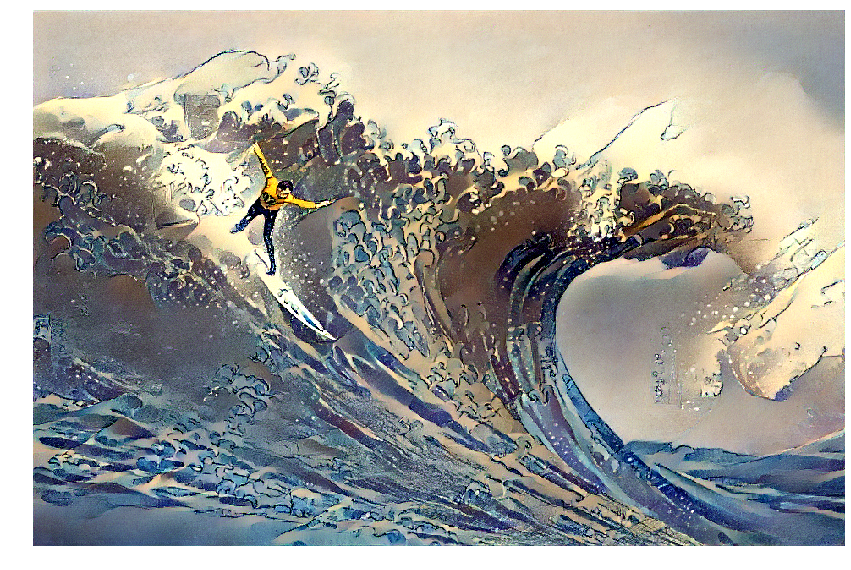

In [31]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
im = plt.imshow(np.rollaxis(input_tensor.detach().cpu()[0].clamp(min=0).numpy(), 0, 3))
plt.axis('off');

# Style Experiments

Different choices of activations and optimizers produce different results. See the `style_transfer_experiments` notebook for more details.

# Effect of Activation Type

Using different types of activations (conv layers, batchnorm layers, ReLU layers) produces different aesthetic results

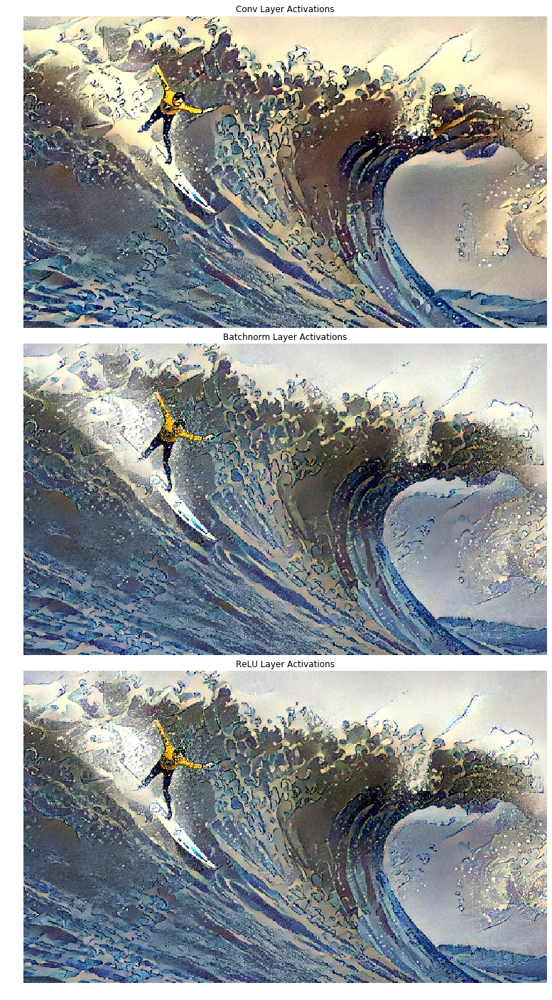

In [46]:
im1 = plt.imread('styles/conv_all_lbfgs.jpg')
im2 = plt.imread('styles/bn_all_lbfgs.jpg')
im3 = plt.imread('styles/relu_all_lbfgs.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('Conv Layer Activations')

axes[1].imshow(im2)
axes[1].set_title('Batchnorm Layer Activations')

axes[2].imshow(im3)
axes[2].set_title('ReLU Layer Activations');

# Effect of Layer Depth

Using earlier or later activations from the convolutional model results in different styles.

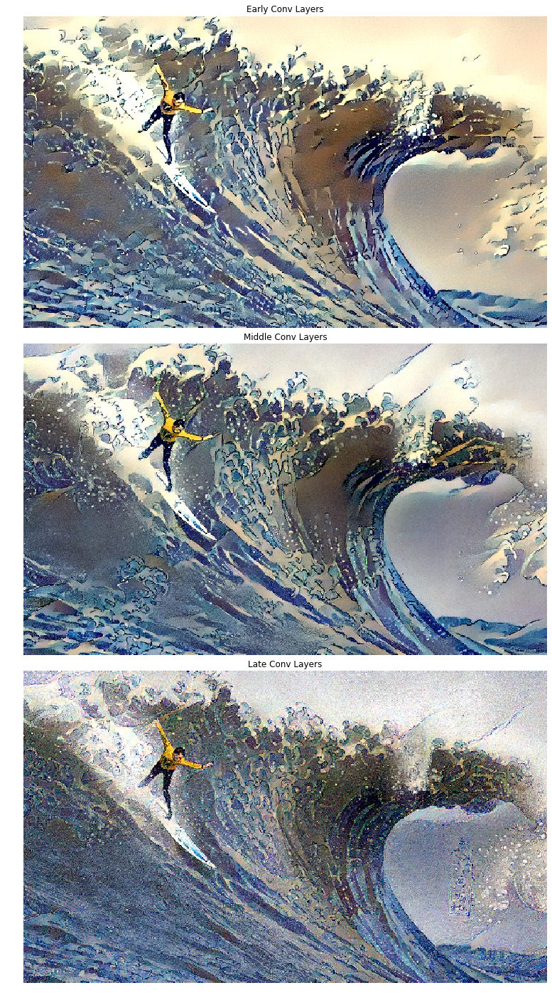

In [45]:
im1 = plt.imread('styles/conv_early_lbfgs.jpg')
im2 = plt.imread('styles/conv_middle_lbfgs.jpg')
im3 = plt.imread('styles/conv_late_lbfgs.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('Early Conv Layers')

axes[1].imshow(im2)
axes[1].set_title('Middle Conv Layers')

axes[2].imshow(im3)
axes[2].set_title('Late Conv Layers');

# Effect of Optimizer 

Different optimizers produce different results. LBFGS seems to converge the fastest and give the cleanest images.

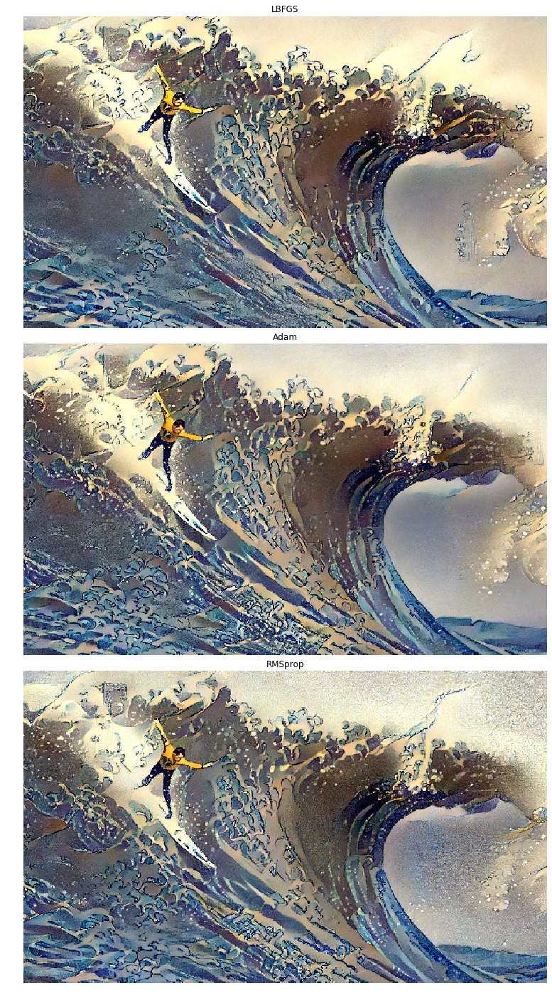

In [47]:
im1 = plt.imread('styles/conv_all_lbfgs.jpg')
im2 = plt.imread('styles/conv_all_adam.jpg')
im3 = plt.imread('styles/conv_all_rms.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('LBFGS')

axes[1].imshow(im2)
axes[1].set_title('Adam')

axes[2].imshow(im3)
axes[2].set_title('RMSprop');

# More Examples

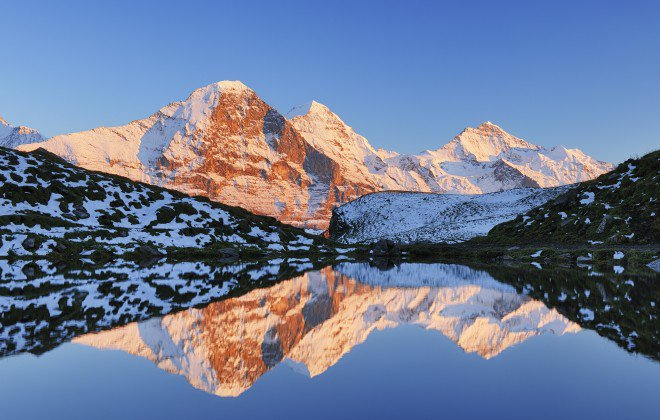

In [49]:
cnt_fn = 'styles/alps.jpg'
cnt_img_ob = PIL.Image.open(cnt_fn)
cnt_img_ob

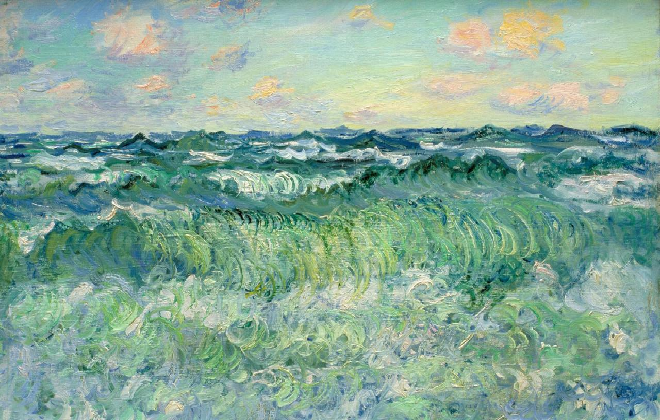

In [55]:
style_fn = 'styles/monet.jpg'
style_img_ob = PIL.Image.open(style_fn)
style_img_ob = style_img_ob.resize((660, 420))
style_img_ob

In [56]:
cnt_tensor = pil2tensor(cnt_img_ob)

In [57]:
style_tensor = pil2tensor(style_img_ob)

In [58]:
cnt_tensor = cnt_tensor[None].cuda()

In [59]:
style_tensor = style_tensor[None].cuda()

In [60]:
block_ends = [0, 3, 7, 10, 14, 17, 20, 24, 27, 30, 34, 37, 40]

In [61]:
sfs = [SaveFeatures(list(m_vgg.children())[idx]) for idx in block_ends]
m_vgg(style_tensor);

In [62]:
targ_styles = [o.features.clone().detach().requires_grad_(False) for o in sfs]
targ_stats = [get_style_vals(i) for i in targ_styles]

In [63]:
input_tensor = cnt_tensor.clone().detach().requires_grad_(True)
opt = optim.LBFGS([input_tensor])

In [64]:
n_iter=0
while n_iter <= 500: opt.step(partial(step,wass_loss))

Iteration: 50, loss: 2.775108575820923
Iteration: 100, loss: 1.4495184421539307
Iteration: 150, loss: 1.016077995300293
Iteration: 200, loss: 0.8392314910888672
Iteration: 250, loss: 0.7226040363311768
Iteration: 300, loss: 0.6474440097808838
Iteration: 350, loss: 0.6042659282684326
Iteration: 400, loss: 0.5780744552612305
Iteration: 450, loss: 0.5558807849884033
Iteration: 500, loss: 0.5383083820343018


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


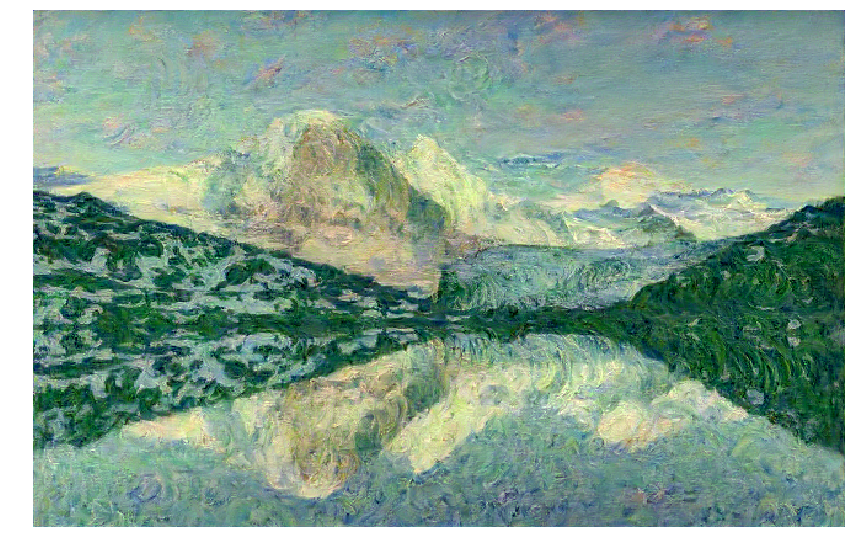

In [65]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
im = plt.imshow(np.rollaxis(input_tensor.detach().cpu()[0].clamp(min=0).numpy(), 0, 3))
plt.axis('off');

In [66]:
fig.savefig('styles/monet_style.jpg', bbox_inches='tight', dpi=100, pad_inches=-1)

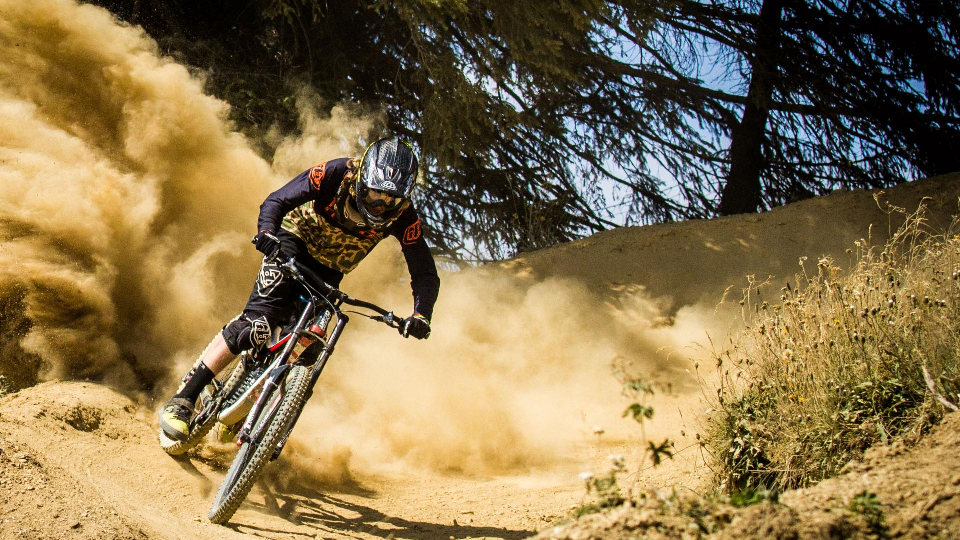

In [89]:
cnt_fn = 'styles/biking.jpg'
cnt_img_ob = PIL.Image.open(cnt_fn).resize((960, 540))
cnt_img_ob

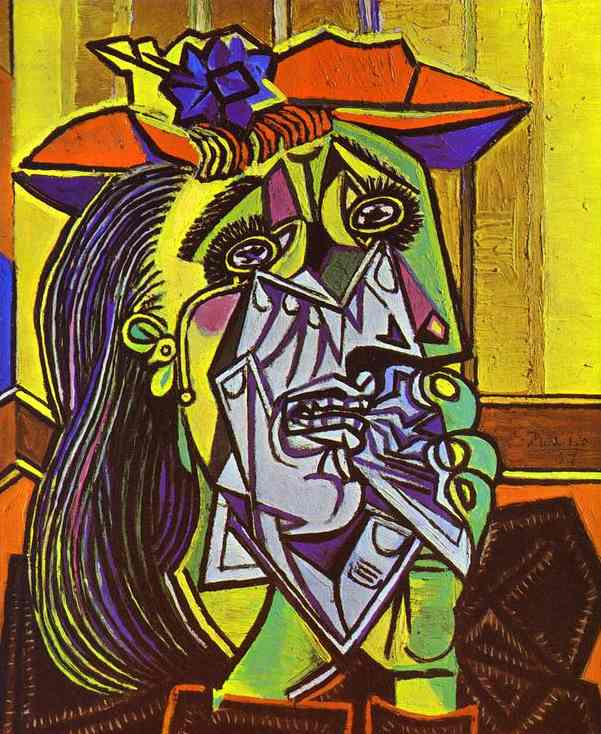

In [91]:
style_fn = 'styles/cubism.jpg'
style_img_ob = PIL.Image.open(style_fn)
#style_img_ob = style_img_ob.resize((660, 420))
style_img_ob

In [92]:
cnt_tensor = pil2tensor(cnt_img_ob)

In [93]:
style_tensor = pil2tensor(style_img_ob)

In [94]:
cnt_tensor = cnt_tensor[None].cuda()

In [95]:
style_tensor = style_tensor[None].cuda()

In [96]:
block_ends = [0, 3, 7, 10, 14, 17, 20, 24, 27, 30, 34, 37, 40]

In [97]:
sfs = [SaveFeatures(list(m_vgg.children())[idx]) for idx in block_ends]
m_vgg(style_tensor);

In [98]:
targ_styles = [o.features.clone().detach().requires_grad_(False) for o in sfs]
targ_stats = [get_style_vals(i) for i in targ_styles]

In [102]:
input_tensor = cnt_tensor.clone().detach().requires_grad_(True)
opt = optim.LBFGS([input_tensor])

In [103]:
n_iter=0
while n_iter <= 200: opt.step(partial(step,wass_loss))

Iteration: 50, loss: 4.234254360198975
Iteration: 100, loss: 2.807870864868164
Iteration: 150, loss: 2.322420120239258
Iteration: 200, loss: 2.099790573120117


In [106]:
n_iter=0
while n_iter <= 200: opt.step(partial(step,wass_loss))

Iteration: 50, loss: 1.931727409362793
Iteration: 100, loss: 1.8599462509155273
Iteration: 150, loss: 1.810720443725586
Iteration: 200, loss: 1.7669801712036133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


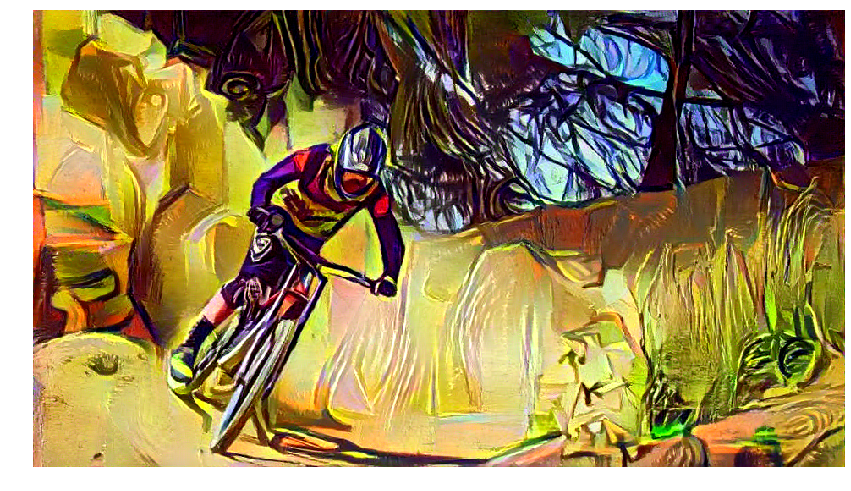

In [107]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
im = plt.imshow(np.rollaxis(input_tensor.detach().cpu()[0].clamp(min=0).numpy(), 0, 3))
plt.axis('off');

In [108]:
fig.savefig('styles/cubism_style.jpg', bbox_inches='tight', dpi=100, pad_inches=-1)